In [55]:
import cv2
import numpy as np
import matplotlib.pyplot as plt


In [56]:
# Load image and convert to grayscale
path = "./images/"
noisy_messi = cv2.imread(path + "messi-gaussian.png")
noisy_messi = cv2.cvtColor(noisy_messi, cv2.COLOR_RGB2GRAY)


In [57]:
# Load original image
path = "./images/"
messi = cv2.imread(path + "messi.png")
messi = cv2.cvtColor(messi, cv2.COLOR_RGB2GRAY)


## Gaussian Noise

In [58]:
def pad_img(img, kernel_size):
    # Compute padding
    pad_size = int(np.floor(kernel_size/2))
    # Pad the image
    padded_image = np.pad(img, pad_width=pad_size,
                          mode="constant", constant_values=0)
    return padded_image


In [59]:
# This function apply takes an image and a nxn filters and returns the 
# application of the filter to the image.

# The filter is applied performing a summation of the pairwise product of the filter with
# the current window

# Useful to apply gaussian and box filter without rewriting the code
def apply_filter(img, filter):
    h, w = img.shape
    # Take kernel size (only squared filters)
    kernel_size = filter.shape[0]
    # Pad the image
    padded_image = pad_img(img, kernel_size)
    # Create our output image
    output_img = np.zeros_like(img)

    # Sliding window
    for i in range(0, h):
        for j in range(0, w):
            output_img[i, j] = np.sum(
                filter * padded_image[i:i+kernel_size, j:j+kernel_size])
    return output_img


In [60]:
def gaussian_filter(img):

    # Compute the 2D gaussian kernel matrix
    def gkern(l=3, sig=3):
        """
        creates gaussian kernel with side length `l` and a sigma of `sig`
        """
        ax = np.linspace(-(l - 1) / 2., (l - 1) / 2., l)
        gauss = np.exp(-0.5 * np.square(ax) / np.square(sig))
        kernel = np.outer(gauss, gauss)
        return kernel / np.sum(kernel)

    gaussian = gkern(3, 3)
    
    # Apply the filter to the image
    return apply_filter(img, gaussian)


gaussian_img = gaussian_filter(noisy_messi)


In [61]:
def box_filter(img, kernel_size=3):
    # Compute box filter as 
    normalize = 1/(kernel_size * kernel_size)
    box = normalize * np.ones(shape=(kernel_size, kernel_size))
    return apply_filter(img, box)


box_img = box_filter(noisy_messi)


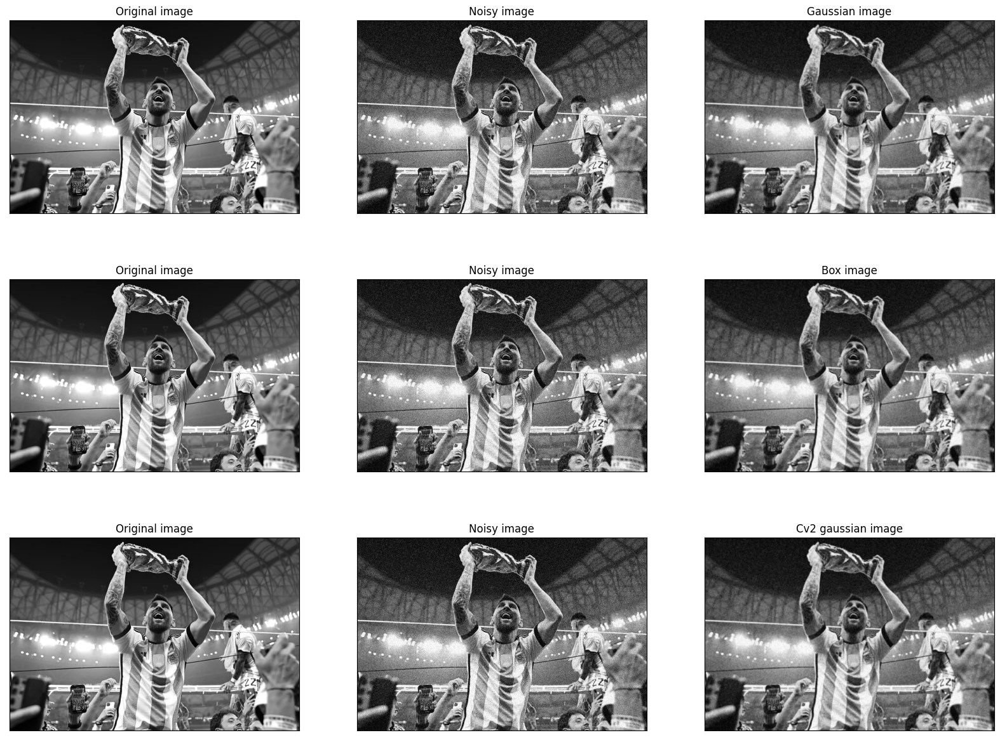

In [62]:
# Compute the gaussian image using cv2 library
gauss_cv2 = cv2.GaussianBlur(noisy_messi, (3, 3), 3)


# Plot the original image along the gaussian denoised image
plt.figure(figsize=(20, 15))
plt.subplot(3, 3, 1)
plt.title("Original image"), plt.xticks([]), plt.yticks([])
plt.imshow(messi, cmap='gray')
plt.xticks([]), plt.yticks([])

plt.subplot(3, 3, 2)
plt.title("Noisy image"), plt.xticks([]), plt.yticks([])
plt.imshow(noisy_messi, cmap='gray')
plt.xticks([]), plt.yticks([])

plt.subplot(3, 3, 3)
plt.title("Gaussian image"), plt.xticks([]), plt.yticks([])
plt.imshow(gaussian_img, cmap='gray')

# Plot the original image along the box filter denoised image
plt.subplot(3, 3, 4)
plt.title("Original image"), plt.xticks([]), plt.yticks([])
plt.imshow(messi, cmap='gray')
plt.xticks([]), plt.yticks([])


plt.subplot(3, 3, 5)
plt.title("Noisy image"), plt.xticks([]), plt.yticks([])
plt.imshow(noisy_messi, cmap='gray')
plt.xticks([]), plt.yticks([])

plt.subplot(3, 3, 6)
plt.title("Box image"), plt.xticks([]), plt.yticks([])
plt.imshow(box_img, cmap='gray')

# Plot the original image along the gaussian cv2 denoised image
plt.subplot(3, 3, 7)
plt.title("Original image"), plt.xticks([]), plt.yticks([])
plt.imshow(messi, cmap='gray')
plt.xticks([]), plt.yticks([])

plt.subplot(3, 3, 8)
plt.title("Noisy image"), plt.xticks([]), plt.yticks([])
plt.imshow(noisy_messi, cmap='gray')
plt.xticks([]), plt.yticks([])

plt.subplot(3, 3, 9)
plt.title("Cv2 gaussian image"), plt.xticks([]), plt.yticks([])
plt.imshow(gauss_cv2, cmap='gray')
plt.xticks([]), plt.yticks([]);



We can see from the value of the PSNR that the gaussian filter gives slightly better results. 

In [63]:
# PSNR value for the images
print('PSNR for gaussian filter cv2: ', cv2.PSNR(messi, gauss_cv2))
print('PSNR for gaussian filter: ', cv2.PSNR(messi, gaussian_img))
print('PSNR for box filter:', cv2.PSNR(messi, box_img))


PSNR for gaussian filter cv2:  26.139772022757843
PSNR for gaussian filter:  25.97565337042932
PSNR for box filter: 25.888311473278442


## Salt and pepper noise

In [64]:
# Load our image with salt and pepper noise
sp_img = cv2.imread(path + 'salt-and-pepper-messi2.png')
sp_img = cv2.cvtColor(sp_img, cv2.COLOR_RGB2GRAY)


In [65]:
# Apply the median filter to the input image, kernel_size is also an input
def median_filter(img, kernel_size=3):
    h, w = img.shape
    # Pad the image
    padded_image = pad_img(img, kernel_size)
    output_img = np.zeros_like(img)
    # Sliding window
    for i in range(0, h):
        for j in range(0, w):
            # Use numpy to find the median value of the current window
            output_img[i, j] = np.median(
                padded_image[i:i+kernel_size, j:j+kernel_size])
    return output_img


In [66]:
# Apply filters to the image
gaussian_sp_img = gaussian_filter(sp_img)
median_sp_img = median_filter(sp_img)


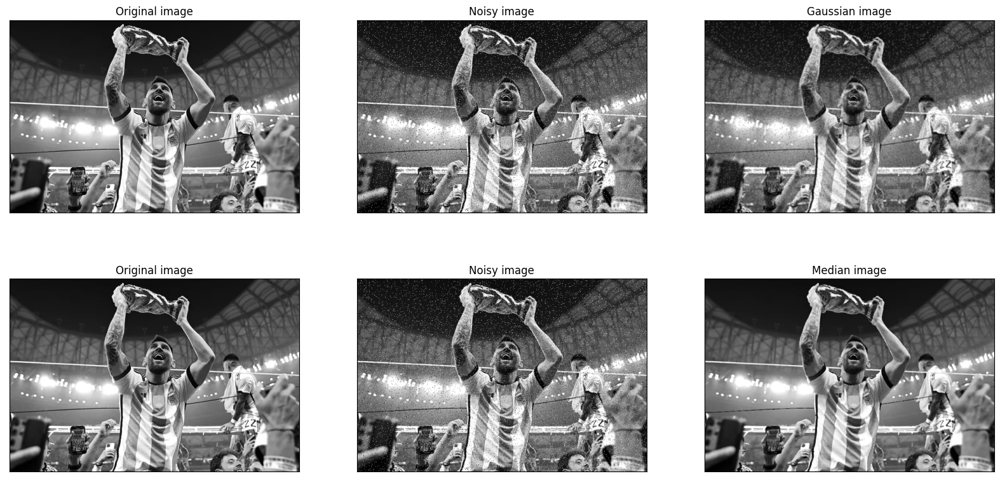

In [67]:

plt.figure(figsize=(20, 15))

# Plot the original image the noisy image and the gaussian filtered 
plt.subplot(3, 3, 1)
plt.title("Original image"), plt.xticks([]), plt.yticks([])
plt.imshow(messi, cmap='gray')
plt.xticks([]), plt.yticks([])

plt.subplot(3, 3, 2)
plt.title("Noisy image"), plt.xticks([]), plt.yticks([])
plt.imshow(sp_img, cmap='gray')
plt.xticks([]), plt.yticks([])

plt.subplot(3, 3, 3)
plt.title("Gaussian image"), plt.xticks([]), plt.yticks([])
plt.imshow(gaussian_sp_img, cmap='gray')


# Plot the original image the noisy image and the median filtered
plt.subplot(3, 3, 4)
plt.title("Original image"), plt.xticks([]), plt.yticks([])
plt.imshow(messi, cmap='gray')
plt.xticks([]), plt.yticks([])

plt.subplot(3, 3, 5)
plt.title("Noisy image"), plt.xticks([]), plt.yticks([])
plt.imshow(sp_img, cmap='gray')
plt.xticks([]), plt.yticks([])

plt.subplot(3, 3, 6)
plt.title("Median image"), plt.xticks([]), plt.yticks([])
plt.imshow(median_sp_img, cmap='gray');



We can see from the value of the PSNR that the median filter gives better results. 

In [68]:
# PSNR value for the images
print('PSNR for gaussian filter: ', cv2.PSNR(messi, gaussian_sp_img))
print('PSNR for median filter:', cv2.PSNR(messi, median_sp_img))


PSNR for gaussian filter:  24.360914744485388
PSNR for median filter: 29.7365502701187


4. Describe the discrepancies between the two reference corrupted images: How are Gaussian
noise and salt and pepper noise different? What is the best denoising method for these two
types of noisy images? (You can use your findings and materials discussed in the classroom)

Possible filters:
1. Gaussian: a gaussian filter performs a weighted sum of the pixel neighbours.
3. Box: a box filter replace each pixel with the average of its neighborhood.
2. Median: a median filter selects the median value of our kernel.

Possible noises:
1. Salt and pepper noise is an impulsive and multiplicative type of noise and it is caused by errors in transmission, analog digital error etc.
In an image with S&P noise we have pixels that results to have values in the extremes of their possible range of values.
A noisy pixel diffears significantly from its neighbour. To denoise an image affected by salt and pepper a median filter can be a good solution.
For this type of noise we know that is really sparse and for this reason, in a median filter, it is unlike to have the noise pixel in the middle position. The gaussian filter does not really work because propagates the error to the neighborhood.

2. The gaussian noise is an additive type of noise $$noise\_img(x, y) = original(x, y) + noise(x,y)$$
where the value of the pertubation comes from a normal probability distribution.
A gaussian filter removes the high-frequencies components of the images giving a smooth effect to that.
Unlike the box filter this one gives, more weight to the pixel near the center of the window then far ones. Usually a gaussian filter produce better results than a box filter. 

# Canny edge detector

2.1. Briefly describe the 4 main steps of Canny edge detection.

The canny edge detector is composed by four step:
1. filter the image using the x and y derivate of Gaussian
2. compute the magnitude and the orientation of the gradient
3. perform non maxima suppresion to have nice thin edges
4. hysteresis step: used to connect disconnected edges. It uses two thresholds: one for find strong edges and the other to connect possible edges that are not above the first threshold but still they are above the second one.

In [69]:
# Load image
canny_img = cv2.imread(path + "cntower.jpg")
canny_img = cv2.cvtColor(canny_img, cv2.COLOR_RGB2GRAY)


In [70]:
# Compute canny edge detector
def edge_detector(img, kernel_size, low, high):
    # First blur the image
    blurred = cv2.GaussianBlur(img, kernel_size, sigmaX=3)
    # Opencv to get the edges
    edges = cv2.Canny(blurred, low, high)
    return edges, blurred


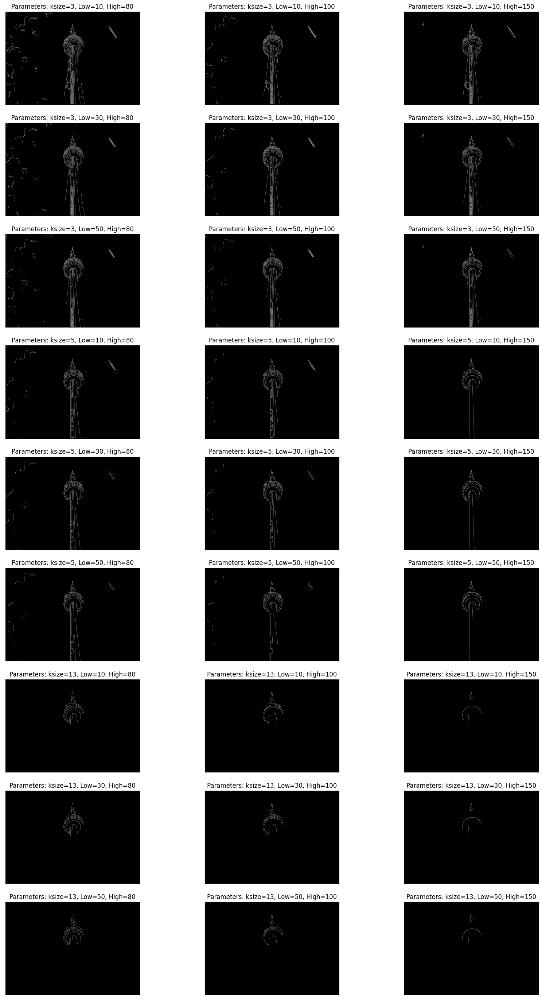

In [71]:
import itertools
# Our parameters for the detector:
params = [
    [3, 5, 13],    # Gaussian blur size
    [10, 30, 50],  # Low treshold
    [80, 100, 150] # High treshold
]

# Compute the number of rows for the subplots
columns = 3
total = 1
for x in params:
    total = total * len(x)

rows = int(np.ceil(total / columns))
plt.figure(figsize=(20, 35))

# Iterate over each combination of our parameters
for i, combination in enumerate(itertools.product(*params)):
    # Retrieve the current parameters values
    ksize, low, high = combination
    edges, blurred = edge_detector(canny_img, (ksize, ksize), low, high)

    # Plot the image
    plt.subplot(rows, columns, i+1)
    plt.xticks([])
    plt.yticks([])
    plt.title(f"Parameters: ksize={ksize}, Low={low}, High={high}")
    plt.imshow(edges, cmap="gray")


2.3 Describe how changing values of each parameter (K, L, U) affects the overall edge detection
results. Is there any relationship between parameters?

The three parameters used for the edge detection are:
1. Gaussian size: a bigger kernel size of this filter makes the image more smooth making the edge detection more difficult. From the plots we can easily see that with a large size of the kernel less edges are detected.
2. Low threshold: used in the hysteresis process, a low value makes more edges connected between them, with an high value there are less connecetions between edges. We can notice that with the value of 10 there are some edges that are not relevant while with the value of 50 we lose the main edges of the tower.
3. High threshold: its values regulates which pixels becomes edges and which not. In the figure an high value of this threshold implies less edges in the image (we can see how the clouds' edges disappears). With the lowest value of this parameter less important edges are displayed and connected following the low value of the thresholding implying a more confused image. 

2.4 Combine parameters in such a way that edges related to the CN tower are detected (remove
other edges related to clouds, etc.) The best solution will not necessarily be found in the
values listed above, but you can report the best possible option from the 27 combinations
that you have already experimented with. Both approaches are acceptable.

From the 27 combinations available the best combination is the following:
- ksize: 3
- Low threshold: 30
- High threshold: 150 

Almost all the clouds edges are ignored and the major contours of the tower are displayed.
However, we can see that some edges are missing (like the right side of the tower) and we have some irrelevants edges like the ones of the windows.

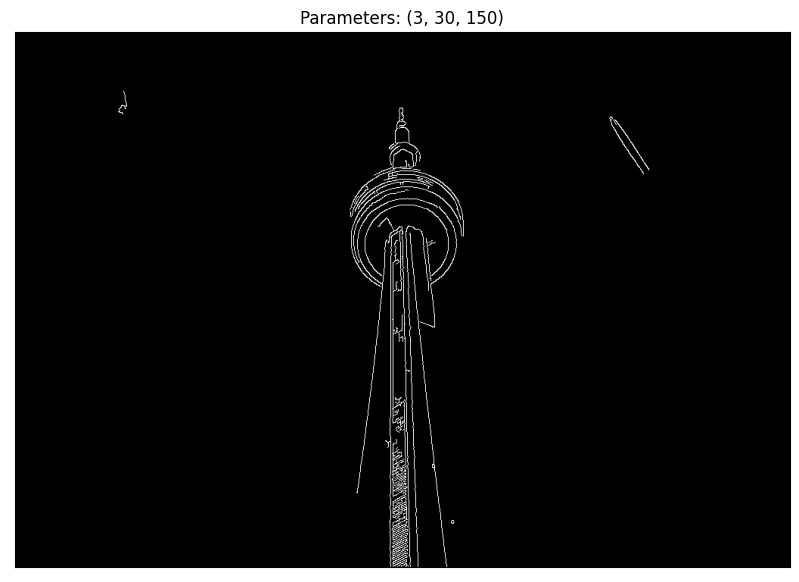

In [72]:
# Best parameters plot
ksize, low, high = 3, 30, 150
manual, blurred = edge_detector(canny_img, (ksize, ksize), low, high)
plt.figure(figsize=(10, 15))
plt.xticks([])
plt.yticks([])
plt.title(f"Parameters: {ksize, low, high}")
plt.imshow(manual, cmap="gray")


# Harris Corner Detection (20 points)

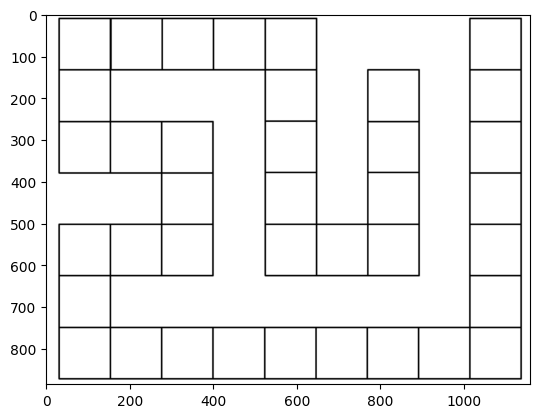

In [73]:
# Load the imae
maze = cv2.imread(path + "template_board.png")
plt.imshow(maze, cmap="gray")

In [74]:
def harris_detector(img, wsize=3, ksize=(3, 3), sigma=1, threshold=0.3, maxima=True):

    # Create a copy of the image
    img_cpy = img.copy()
    # Convert to gray scale and add blur
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    blurred = cv2.GaussianBlur(img, ksize, sigmaX=sigma)


    # sobel filter used to compute the derivates
    scale = 1
    delta = 0
    ddepth = cv2.CV_16S
    
    # Grad x
    grad_x = cv2.Sobel(blurred, ddepth, 1, 0, ksize=3, scale=scale,
                       delta=delta, borderType=cv2.BORDER_DEFAULT)
    # Grad y
    grad_y = cv2.Sobel(blurred, ddepth, 0, 1, ksize=3, scale=scale,

                       delta=delta, borderType=cv2.BORDER_DEFAULT)
    # Product of the derivates
    dxdy = grad_x*grad_y

    # Square the gradients components
    grad_x = np.power(grad_x, 2)
    grad_y = np.power(grad_y, 2)

    # Apply Gaussian filter
    grad_x_gauss = cv2.GaussianBlur(grad_x, ksize, sigma)
    grad_y_gauss = cv2.GaussianBlur(grad_y, ksize, sigma)
    dxdy_gauss = cv2.GaussianBlur(dxdy, ksize, sigma)

    # Compute harris operator
    harris = grad_x_gauss*grad_y_gauss - \
        np.square(dxdy_gauss) - 0.05 * np.square(grad_x_gauss + grad_y_gauss)

    # Normalization
    cv2.normalize(harris, harris, 0, 2, cv2.NORM_MINMAX)

    # non-maxima suppression
    if maxima:
        # Compute the gradient on the harris matrix
        # Grad hx
        grad_hx = cv2.Sobel(harris, ddepth, 1, 0, ksize=3, scale=scale,
                        delta=delta, borderType=cv2.BORDER_DEFAULT)
        # Grad hy
        grad_hy = cv2.Sobel(harris, ddepth, 0, 1, ksize=3, scale=scale,
                        delta=delta, borderType=cv2.BORDER_DEFAULT)

        # Gradient direction
        theta = np.arctan2(grad_hy, grad_hx)
        angle = np.rad2deg(theta)

        # Compute gradient magnitude
        mag = np.hypot(grad_hx,  grad_hy)

        M, N = angle.shape
        non_max = np.zeros((M, N))

        # Iterate over all the image checking which pixels we need to compare given the gradient direction
        for i in range(1, M-1):
            for j in range(1, N-1):
                # Horizontal 0
                if (0 <= angle[i, j] < 22.5) or (157.5 <= angle[i, j] <= 180) or (-22.5 <= angle[i, j] < 0) or (-180 <= angle[i, j] < -157.5):
                    b = mag[i, j+1]
                    c = mag[i, j-1]
                # Diagonal 45
                elif (22.5 <= angle[i, j] < 67.5) or (-157.5 <= angle[i, j] < -112.5):
                    b = mag[i+1, j+1]
                    c = mag[i-1, j-1]
                # Vertical 90
                elif (67.5 <= angle[i, j] < 112.5) or (-112.5 <= angle[i, j] < -67.5):
                    b = mag[i+1, j]
                    c = mag[i-1, j]
                # Diagonal 135
                elif (112.5 <= angle[i, j] < 157.5) or (-67.5 <= angle[i, j] < -22.5):
                    b = mag[i+1, j-1]
                    c = mag[i-1, j+1]

                # If the current pixel is a local maxima let's keep its value
                if (mag[i, j] >= b) and (mag[i, j] >= c):
                    non_max[i, j] = mag[i, j]

                # Otherwise set it to zero 
                else:
                    non_max[i, j] = 0

        # Normalization
        cv2.normalize(non_max, non_max, 0, 2, cv2.NORM_MINMAX)
        # Tresholding
        loc = np.where(non_max >= threshold)

    else:
        # Tresholding
        loc = np.where(harris >= threshold)

        
    # Circle the corners
    for pt in zip(*loc[::-1]):
        cv2.circle(img_cpy, pt, 3, (255, 0, 0), -1)

    return harris, img_cpy


In [75]:
# Compute and plot the harris detector comparing the effect of the non-maxima suppression
# Two thresholds are used in the two versions of the detector
# There are two thresholds because the two versions of the corner detector act differently with the same threshold
# without the suppression we need an higher value to isolate the real corners
# while with the suppression a lower threshold is enough.
def plot_harris(img, th1=1.5, th2=1.5):
    # Harris with no suppression
    harris, corners = harris_detector(img, threshold=th1, maxima=False)
    # Harris with suppression
    harris, corners_maxima = harris_detector(img, threshold=th2, maxima=True)

    # Plot the two version of the harris detectors
    plt.figure(figsize=(20, 20))
    plt.subplot(1, 2, 1)
    plt.xticks([]), plt.yticks([])
    plt.title("Harris corner without non-maxima suppression, threshold = " + str(th1))
    plt.imshow(corners, cmap="gray")
    plt.subplot(1, 2, 2)
    plt.title("Harris corner with non-maxima suppression, threshold = " + str(th2))
    plt.xticks([]), plt.yticks([])
    plt.imshow(corners_maxima, cmap="gray")


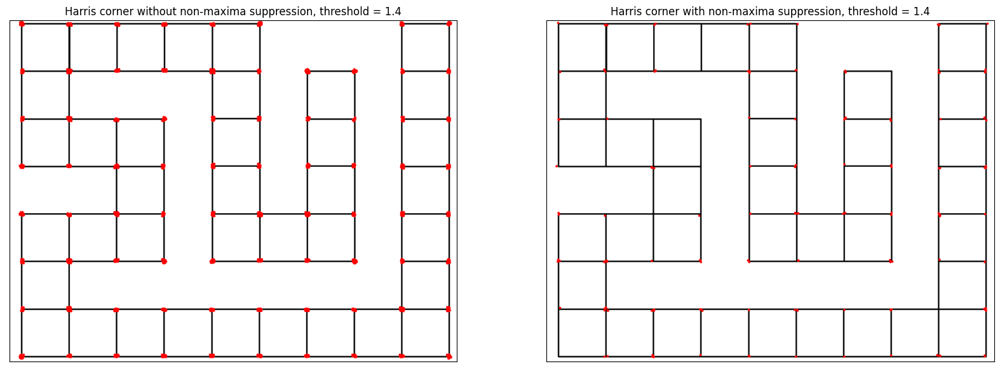

In [76]:
plot_harris(maze, 1.4, 1.4)

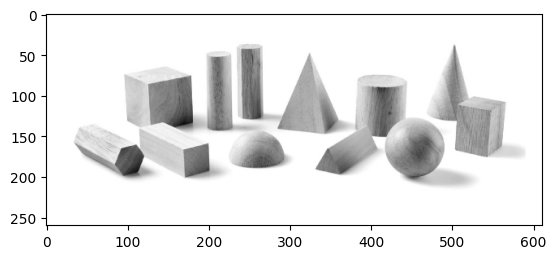

In [77]:
# Second test image
shapes = cv2.imread(path + "shapes.png")
plt.imshow(shapes, cmap="gray")

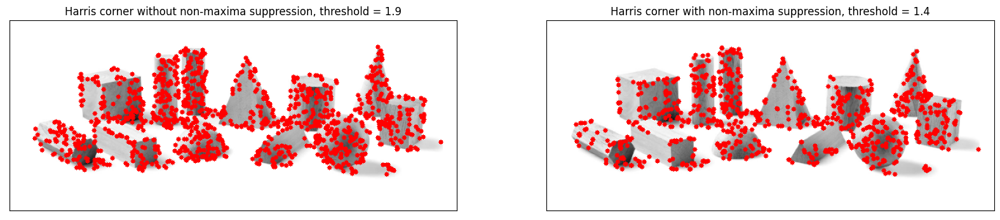

In [78]:
plot_harris(shapes, 1.9, 1.4)

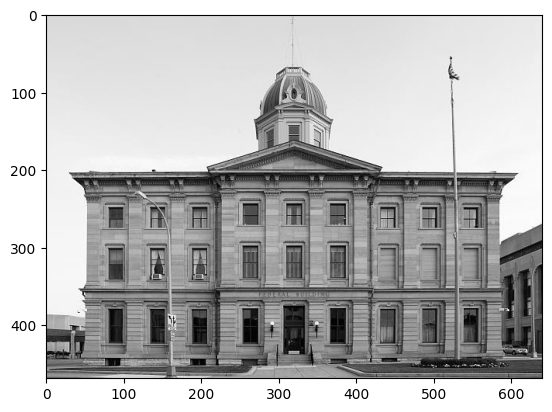

In [79]:
# Third test image
courthouse = cv2.imread(path + "courthouse.jpg")
plt.imshow(courthouse, cmap="gray")


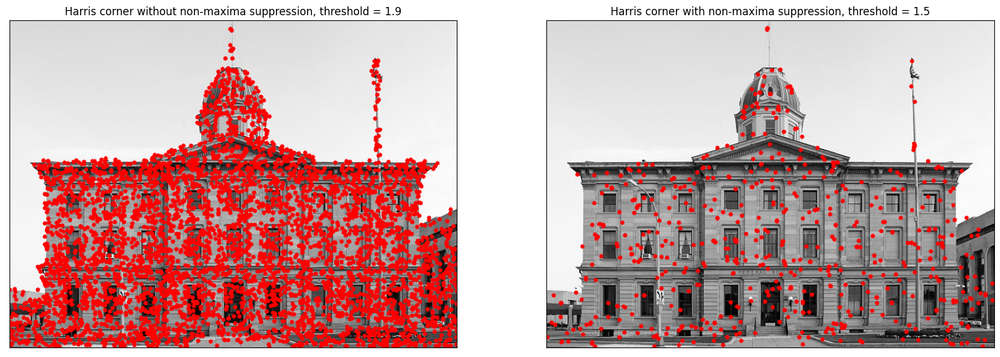

In [80]:
plot_harris(courthouse, 1.9, 1.5)

# Invariance of SIFT Features (30 points) 

Briefly describe the 4 main actions/steps of SIFT method:

The SIFT method for feature detection is composed by four steps:
1. Scale-space extrema selection: the image is scaled with different values and for each is computed the DoG using different values of variance. Once the DoG are obtained we search for local extrema comparing each pixel with its neighbours. This comparison is made also with the above and the below scaled images.
2. Keypoint localization: once we have our possible keys locations we have to discard all the ones that does not have a sufficent amount of relevant information. For example at this point we have also edges as candidates but we are not interested in them. We define our threshold and look to the eigenvalues ratio of the Hessian matrix, we are interested in points were there is a great change in all the directions (corners). For this reason if we have a high value of this eigenvalues ratio it means that all changing is concentrated in one direction (edge). 
3. Orientation assignment: to achieve orientation invariance we need to compute the keypoints orientations. We take a neighborhood of our keypoint and we compute an histogram of gradients directions. For each gradient the value that is added to the relative bin depends of the magnitude of the gradient
4. Keypoint descriptor: a 16x16 matrix is created around the keypoint and it is divided into 16 sub-blocks of 4x4 size. For each sub-block 8 bin histogram is created for a total of 128 values. It is represented as a vector to form keypoint descriptor.

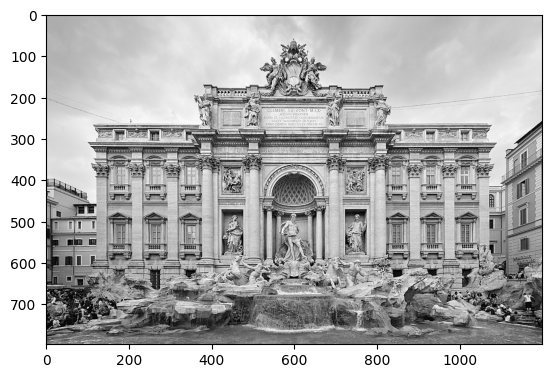

In [81]:
trevi = cv2.imread(path + "TreviFountainRome.jpg")
trevi = cv2.cvtColor(trevi, cv2.COLOR_BGR2GRAY)
plt.imshow(trevi, cmap="gray")


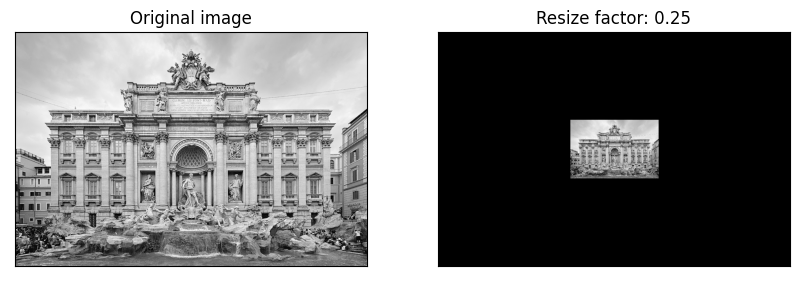

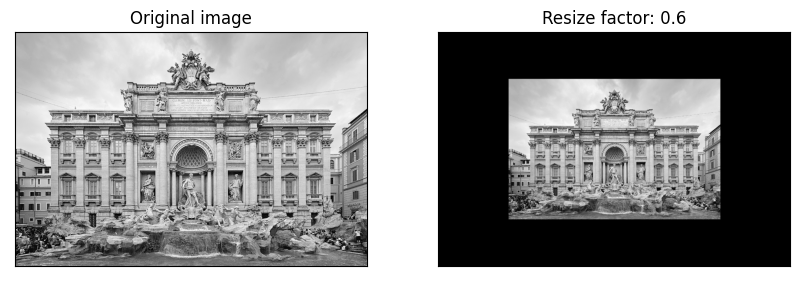

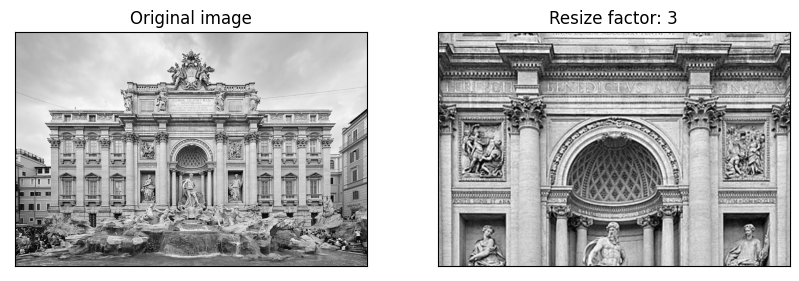

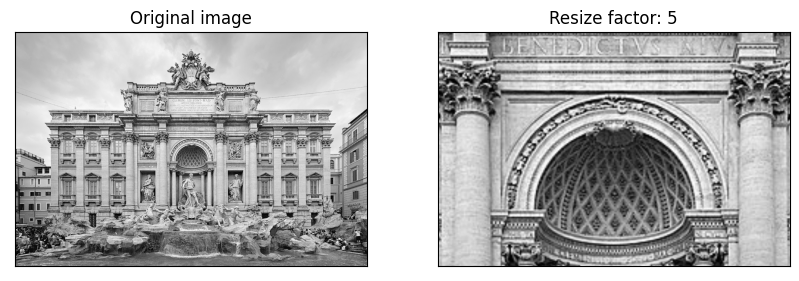

In [82]:
# Scaling factor
scales = [0.25, 0.6, 3, 5]
# Scaled images
trevis = []

# Iterate over the scaling factor
for scale_percent in scales:
    # Get image shape
    height, width = trevi.shape
    # Compute and apply the matrix for scaling 
    M = cv2.getRotationMatrix2D((width/2, height/2), 0, scale_percent)
    resized = cv2.warpAffine(trevi, M, (width, height))

    trevis.append(resized)

# Plot the scaled images
for i, (img, scale) in enumerate(zip(trevis, scales)):
    plt.figure(figsize=(10, 15))

    plt.subplot(1, 2 ,1)
    plt.title("Original image")
    plt.xticks([])
    plt.yticks([])
    plt.imshow(trevi, cmap="gray")

    plt.subplot(1, 2 , 2)
    plt.title("Resize factor: " + str(scale))
    plt.xticks([])
    plt.yticks([])
    plt.imshow(img, cmap="gray")
    plt.show()


In [83]:
""" 
Compute and returns:
- Keypoints
- Keypoints' descriptors
- Image with the corresponding keypoints 
"""
def sift(img):
    sift = cv2.SIFT_create()
    # Compute keypoints and descriptors
    kp, ds = sift.detectAndCompute(img, None)
    # Draw the keypoints on the image
    img = cv2.drawKeypoints(
        img, kp, img, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    return kp, ds, img


In [84]:
# Compute and returns all the keypoints and the descriptors for the images
# given in input
def compute_kp(imgs):
    # List containing the keypoints for each image
    kps = []    # i.e. kps[1] contains the keypoints of the image imgs[1]
    # List containing the descriptots for each image
    dss = []    # i.e. dss[1] contains the descriptors of the image imgs[1]
    total = len(imgs)

    # Compute the number of rows
    columns = 2
    plt.figure(figsize=(15, 15))
    rows = int(np.ceil(total / columns))

    # Iterate over all images
    for i, img in enumerate(imgs):
        # Compute kp and ds and the resulting image
        kp, ds, img = sift(img)

        # Plot the image with the keypoints
        plt.subplot(rows, columns, i+1)
        plt.xticks([])
        plt.yticks([])
        plt.imshow(img)
        kps.append(kp)
        dss.append(ds)
    plt.show()
    return kps, dss


In [85]:
# Compute and plot the matches for the input images given the respective keypoints and descriptors
def match_plot(img1, img2, ds1, ds2, kp1, kp2, title=""):
    
    # Match descriptors.
    # BFMatcher with default params
    bf = cv2.BFMatcher()
    matches = bf.match(ds1, ds2)

    # Sort them in the order of their distance.
    matches = sorted(matches, key=lambda x: x.distance)

    # Draw the matches across the two images
    img3 = cv2.drawMatches(
        img1, kp1, img2, kp2, matches[:10], None, flags=2)

    plt.figure(figsize=(20, 20))
    plt.title("Matches " + title)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(img3)
    plt.show()

    # Number of matches
    n = 100

    # Return the first n matches distances 
    distances = np.zeros(n)
    for i, match in enumerate(matches[:n]):
        distances[i] = match.distance

    return distances


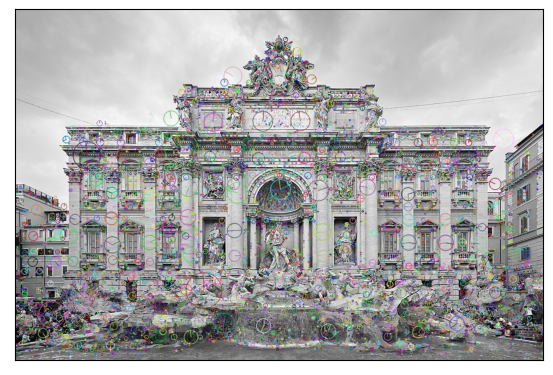

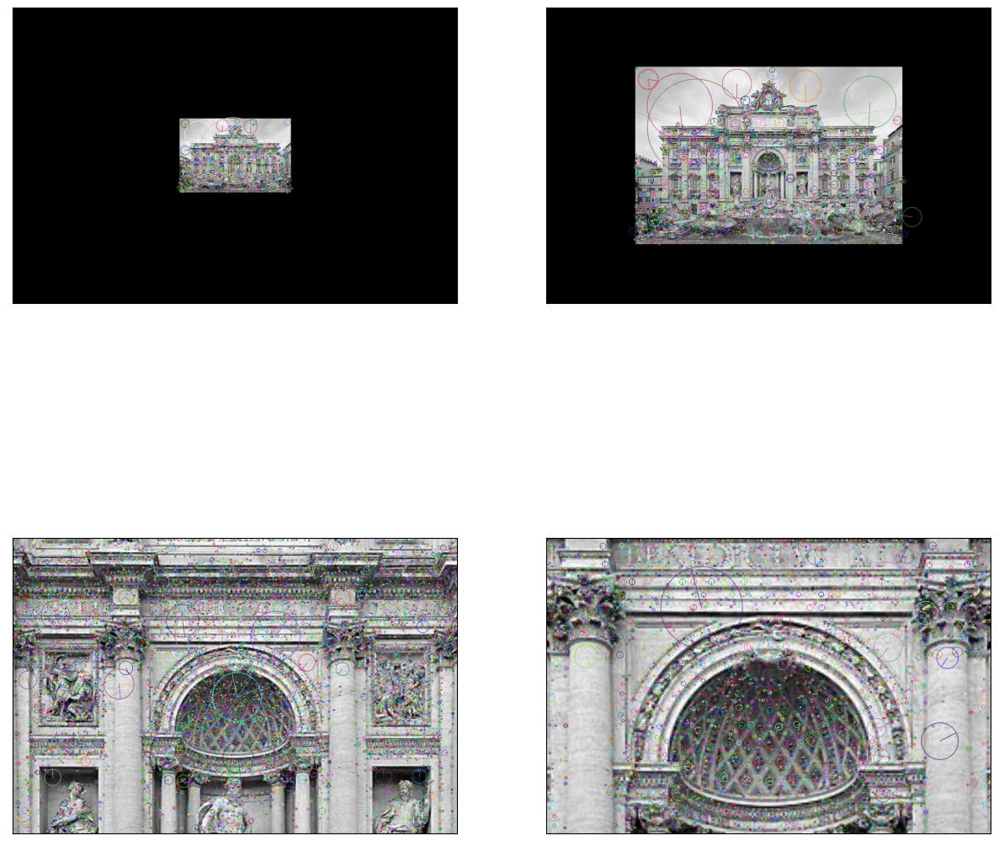

In [86]:
# Compute keypoints and descriptors for the original image
trevi_kp, trevi_ds = compute_kp([trevi])
# Compute keypoints and descriptors for the scaled images
kps, dss = compute_kp(trevis)


In [87]:
# Plot the matching distances
def plot_distances(distances, scales):
# Len of the distances
    x = np.arange(1, len(distances[0])+1)
    legend = []
    plt.title("Matching distances for the top 100 keypoint")
    plt.grid()
    plt.ylabel("Distance")
    plt.xlabel("Distances' index")
    for match, scale in zip(distances, scales):
        plt.plot(x, match)
        legend.append(scale)
    plt.legend(legend)
    plt.show()


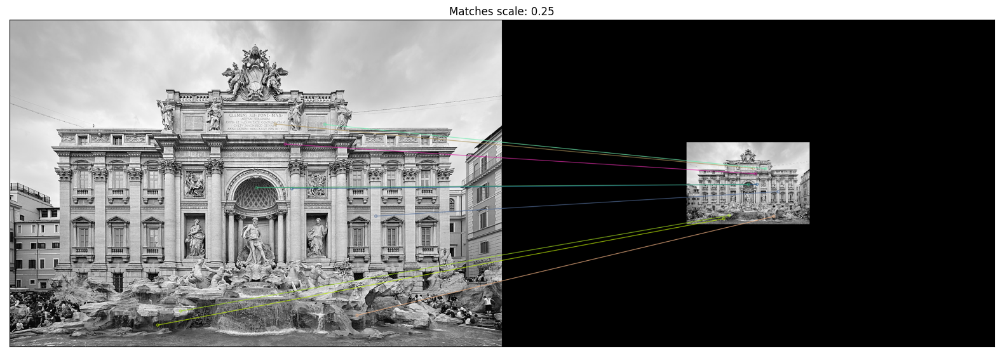

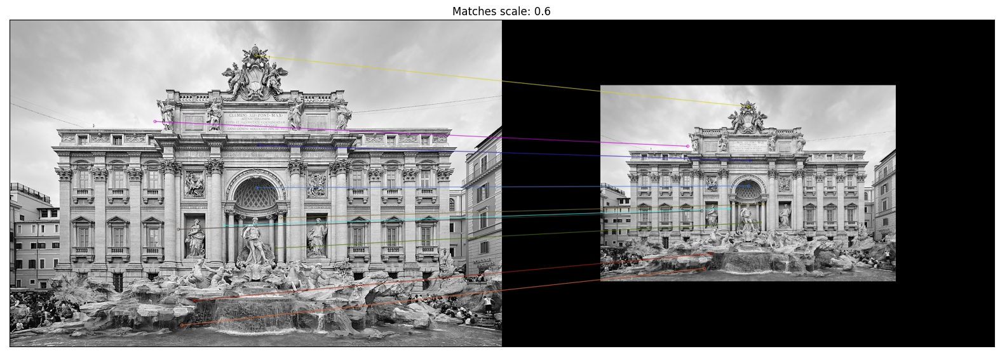

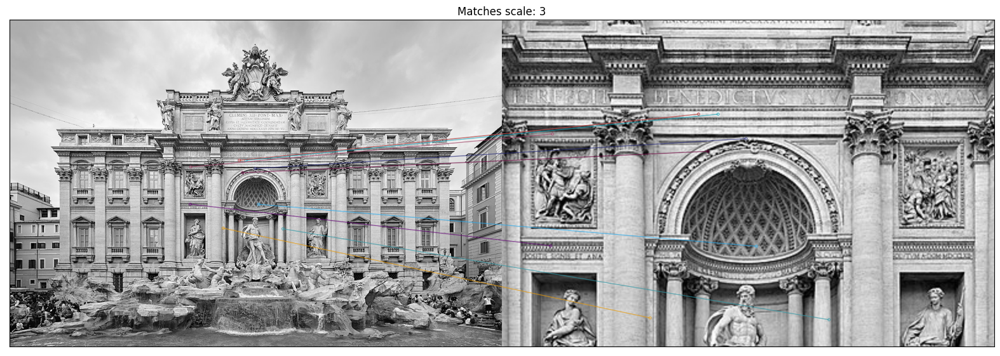

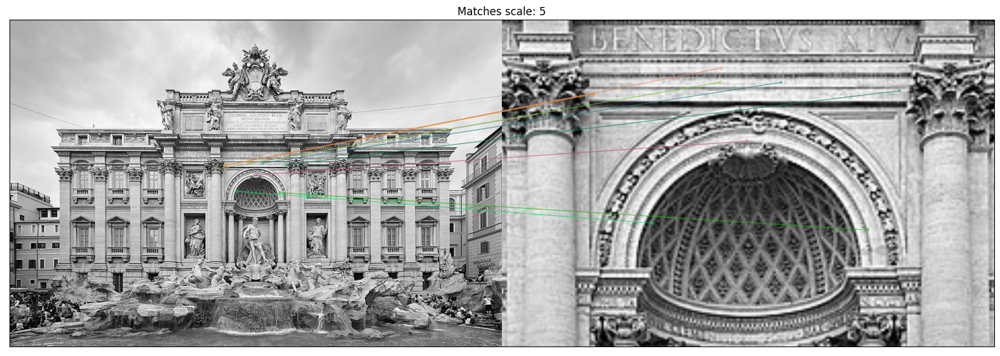

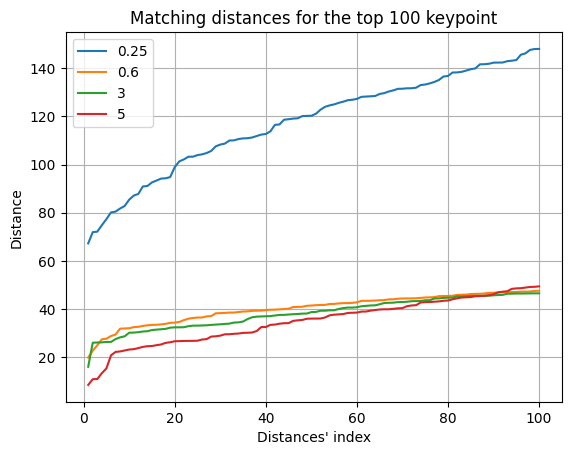

In [88]:
distances = []
# Iterate over each scaled image and the corresponding keypoints and descriptors
for img, kp, ds, scale in zip(trevis, kps, dss, scales):
    # Plot the matches across the two images
    distance = match_plot(trevi, img, trevi_ds[0], ds, trevi_kp[0], kp, title=f"scale: {scale}")
    distances.append(distance)

# Plot the distance value of the smallest n matches
plot_distances(distances, scales)


Discuss the trend in the plotted results. What is the effect of increasing the scale on the matching distance? Explain.

From the plot we can see that there is a big gap from the 0.25 scale and the others scale factors. This is due to the difference between the keypoint descriptors in the original image and in the 0.25 scaled image which. The one in the scaled image results to be "smaller" (the descriptors can be seen as a vector) than the one of the original image while for the other scaling factor we do not have so much difference.



## Rotation

In [89]:
# Rotate the input image using different angles
def rotation(img, angles):
    # Computed rotations
    imgs = []
    
    # Compute rows for the subplot
    rows, cols = img.shape
    n_angles = len(angles)

    plot_columns = 2
    plot_rows = int(np.ceil(n_angles / columns))

    plt.figure(figsize=(10, 8))

    # Iterate over each angle of rotation
    for i, angle in enumerate(angles):
        # Create and apply the rotation matrix
        rotation_matrix = cv2.getRotationMatrix2D((cols/2, rows/2), angle, 1.2) # For 180 degree image if there is no scale factor we get a zero flat line for the matches indices
        img_rotated = cv2.warpAffine(img, rotation_matrix, (cols, rows))

        # Add to the list the new image
        imgs.append(img_rotated)

        # Plot the image
        plt.subplot(plot_rows, plot_columns, i+1)
        plt.title(f"Rotation of {angle} degree")
        plt.xticks([])
        plt.yticks([])
        plt.imshow(img_rotated, cmap="gray")
    plt.show()
    return imgs


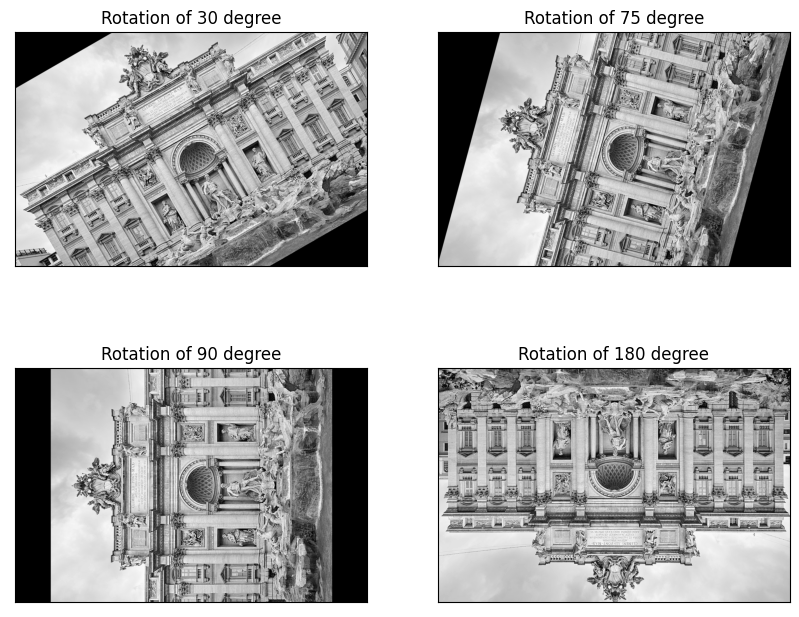

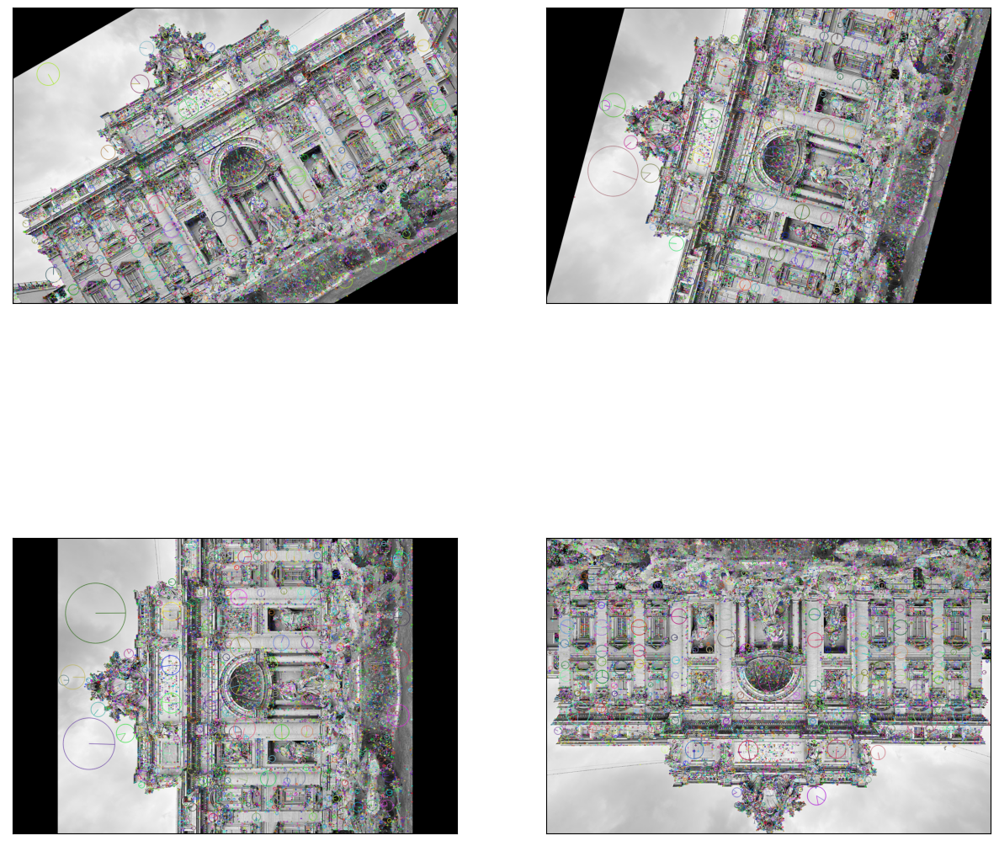

In [90]:
# Compute rotations, keypoints and descriptors
angles = [30, 75, 90, 180]
trevis_rot = rotation(trevi, angles)
kps, dss = compute_kp(trevis_rot)

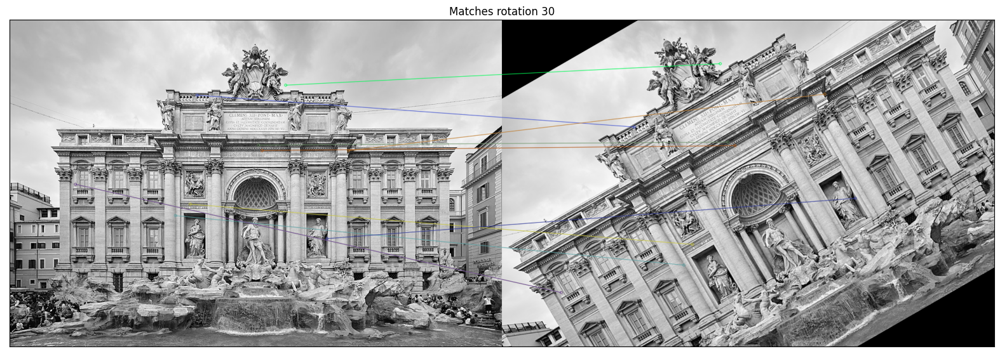

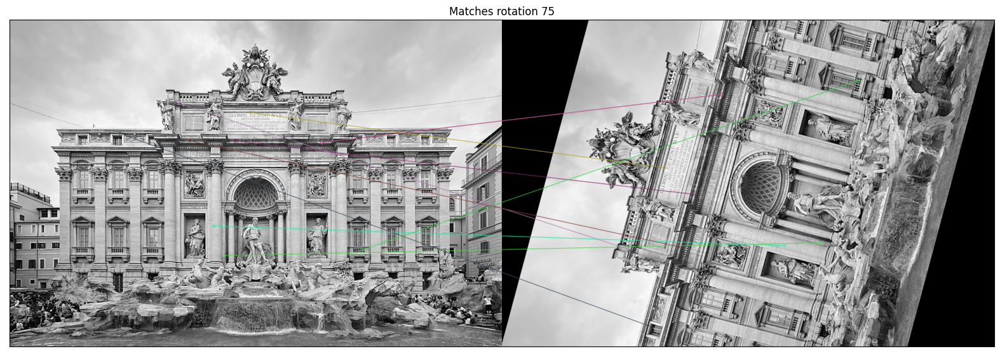

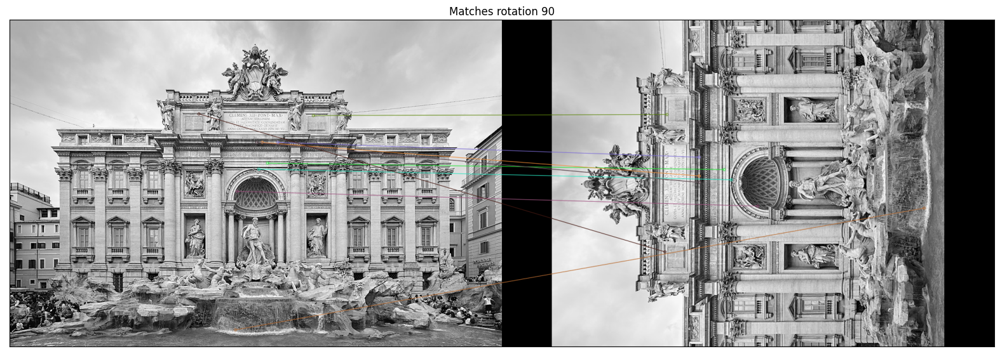

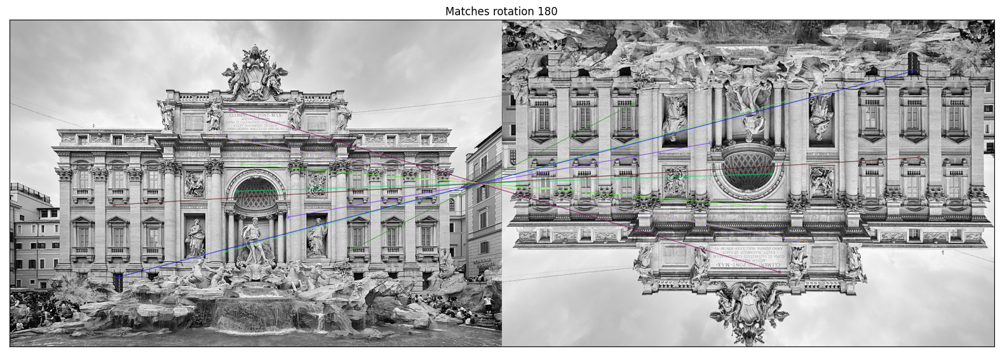

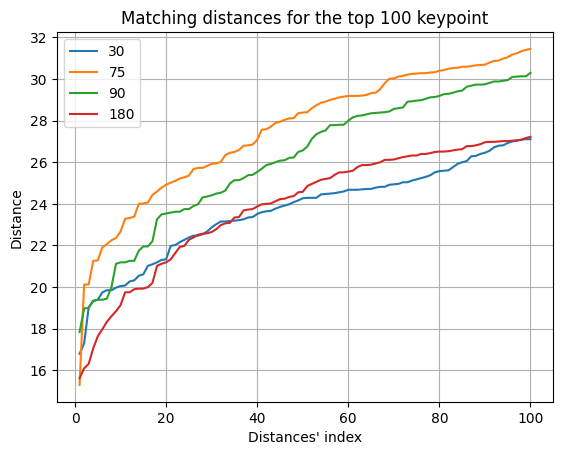

In [91]:
distances = []
# Iterate over each rotated image and the corresponding keypoints and descriptors
for img, kp, ds, angle in zip(trevis_rot, kps, dss, angles):
    dis = match_plot(trevi, img, trevi_ds[0], ds, trevi_kp[0], kp, title=f"rotation {angle}")
    distances.append(dis)

plot_distances(distances, angles)

Discuss the trend in the plotted results. What is the effect of increasing the angle of rotationon the matching distance? Explain.

In this case there is no a real trend, increasing the angle of our rotation does not affect significantly our matching distances. This is because SIFT is rotation invariant and modifying the angle of the image does not significantly changes our keypoint descriptors. The scale remains the same and the only thing that can change is the orientation of our kps. 